<a href="https://colab.research.google.com/github/Espeon196/Brain-Tumor-Radiogenomic-Classification/blob/main/notebook/EDA.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install pydicom

     |████████████████████████████████| 1.9 MB 7.6 MB/s 


In [ ]:
!mkdir -p ~/.kaggle
!cp /content/drive/MyDrive/kaggle/kaggle.json ~/.kaggle/
!chmod 600 ~/.kaggle/kaggle.json
!pip install --force-reinstall --no-deps kaggle
!kaggle -v

     |████████████████████████████████| 58 kB 3.4 MB/s 
  Created wheel for kaggle: filename=kaggle-1.5.12-py3-none-any.whl size=73052 sha256=79b8a79b20db21b217593b0e83e43820064e190c53b9c9ae9ab9c5a15870991d
  Stored in directory: /root/.cache/pip/wheels/62/d6/58/5853130f941e75b2177d281eb7e44b4a98ed46dd155f556dc5
Successfully built kaggle
  Attempting uninstall: kaggle
    Found existing installation: kaggle 1.5.12
    Uninstalling kaggle-1.5.12:
      Successfully uninstalled kaggle-1.5.12
Kaggle API 1.5.12


In [ ]:
!kaggle competitions download -c rsna-miccai-brain-tumor-radiogenomic-classification

100% 12.3G/12.3G [02:09<00:00, 80.6MB/s]
100% 12.3G/12.3G [02:09<00:00, 102MB/s] 


In [ ]:
!unzip /content/rsna-miccai-brain-tumor-radiogenomic-classification.zip -d data

ストリーミング出力は最後の 5000 行に切り捨てられました。
  inflating: data/train/00838/T1wCE/Image-124.dcm  
  inflating: data/train/00838/T1wCE/Image-125.dcm  
  inflating: data/train/00838/T1wCE/Image-126.dcm  
  inflating: data/train/00838/T1wCE/Image-127.dcm  
  inflating: data/train/00838/T1wCE/Image-128.dcm  
  inflating: data/train/00838/T1wCE/Image-129.dcm  
  inflating: data/train/00838/T1wCE/Image-13.dcm  
  inflating: data/train/00838/T1wCE/Image-130.dcm  
  inflating: data/train/00838/T1wCE/Image-131.dcm  
  inflating: data/train/00838/T1wCE/Image-132.dcm  
  inflating: data/train/00838/T1wCE/Image-133.dcm  
  inflating: data/train/00838/T1wCE/Image-134.dcm  
  inflating: data/train/00838/T1wCE/Image-135.dcm  
  inflating: data/train/00838/T1wCE/Image-136.dcm  
  inflating: data/train/00838/T1wCE/Image-137.dcm  
  inflating: data/train/00838/T1wCE/Image-138.dcm  
  inflating: data/train/00838/T1wCE/Image-139.dcm  
  inflating: data/train/00838/T1wCE/Image-14.dcm  
  inflating: data/train/00838/T1wC

In [ ]:
import os 
import json 
import glob
import random
import collections

import numpy as np
import pandas as pd
import pydicom
from pydicom.pixel_data_handlers.util import apply_voi_lut
import cv2
import matplotlib.pyplot as plt
import seaborn as sns

In [ ]:
DATA_PATH = "/content/data/train/"

# Data Visualization

In [ ]:
train_df = pd.read_csv("/content/data/train_labels.csv")
train_df

,BraTS21ID,MGMT_value
0,0,1
1,2,1
2,3,0
3,5,1
4,6,1
...,...,...
580,1005,1
581,1007,1
582,1008,1
583,1009,0


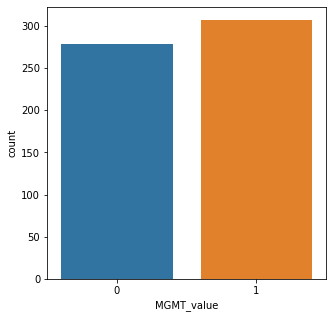

In [ ]:
plt.figure(figsize=(5, 5))
sns.countplot(data=train_df, x="MGMT_value")

In [ ]:
def load_dicom(path):
    dicom = pydicom.read_file(path)
    data = dicom.pixel_array
    data = data - np.min(data)
    if np.max(data) != 0:
        data = data / np.max(data)
    data = (data * 255).astype(np.uint8)
    return data

def visualize_sample(brats21id, slice_i, mgmt_value, types=("FLAIR", "T1w", "T1wCE", "T2w")):
    plt.figure(figsize=(16, 5))
    patient_path = os.path.join(DATA_PATH, str(brats21id).zfill(5))
    for i, t in enumerate(types, 1):
        t_paths = sorted(
            glob.glob(os.path.join(patient_path, t, "*")),
            key=lambda x: int(x[:-4].split("-")[-1])
        )
        data = load_dicom(t_paths[int(len(t_paths)*slice_i)])
        plt.subplot(1, 4, i)
        plt.imshow(data, cmap="gray")
        plt.title(f"{t}", fontsize=16)
        plt.axis("off")

    plt.suptitle(f"MGMT_value: {mgmt_value}", fontsize=16)
    plt.show()

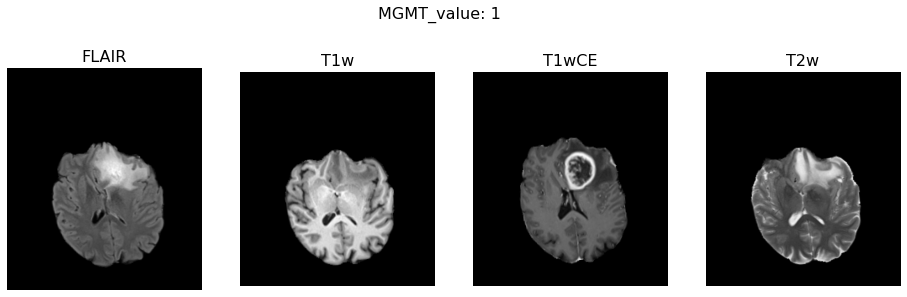

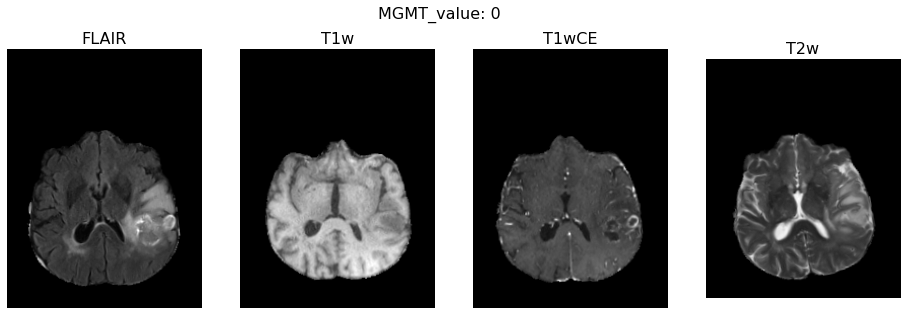

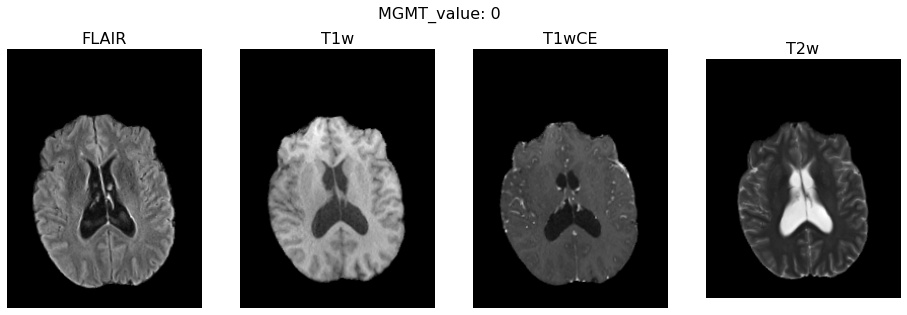

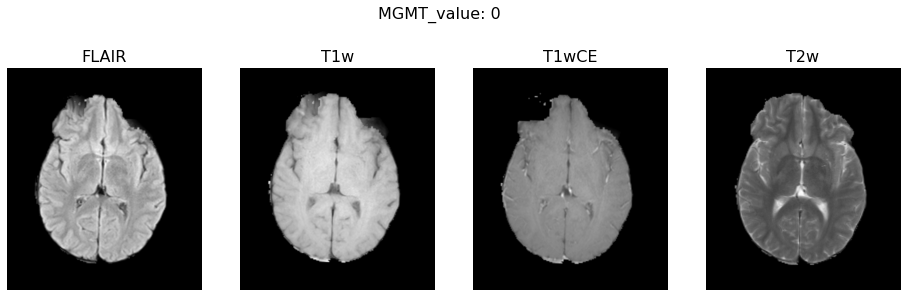

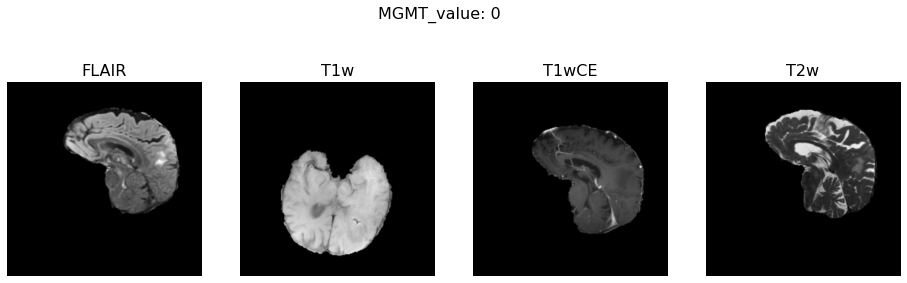

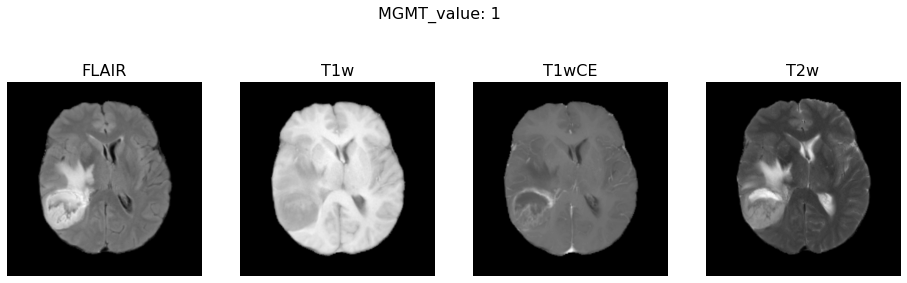

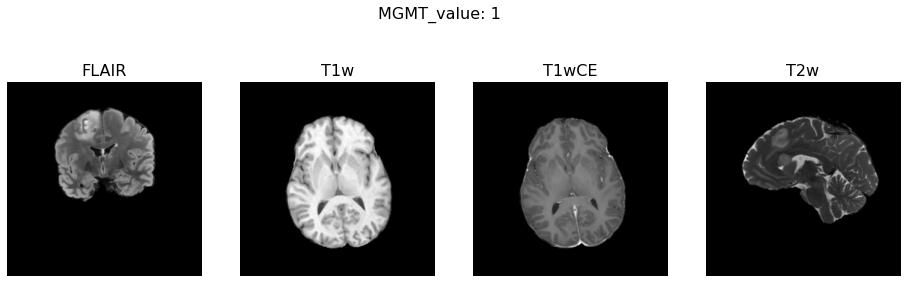

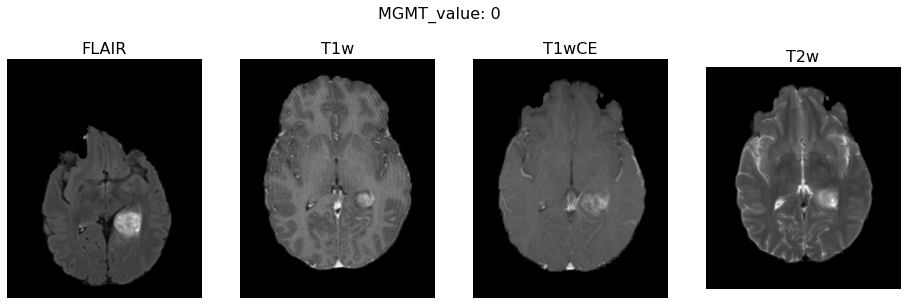

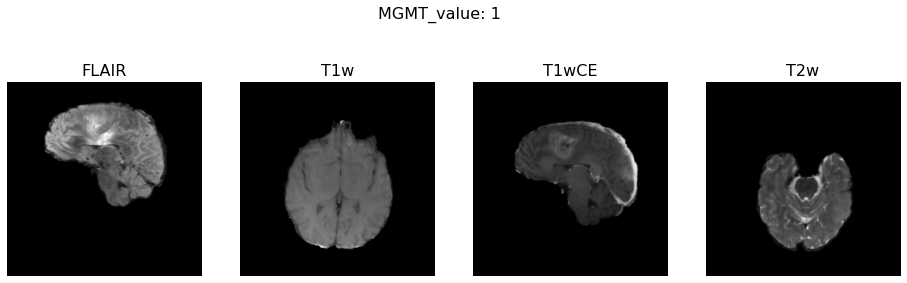

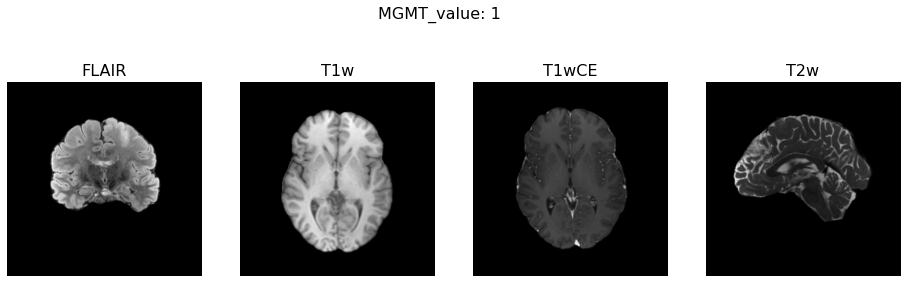

In [ ]:
for i in random.sample(range(train_df.shape[0]), 10):
    _brats21id = train_df.iloc[i]["BraTS21ID"]
    _mgmt_value = train_df.iloc[i]["MGMT_value"]
    visualize_sample(brats21id=_brats21id, mgmt_value=_mgmt_value, slice_i=0.5)

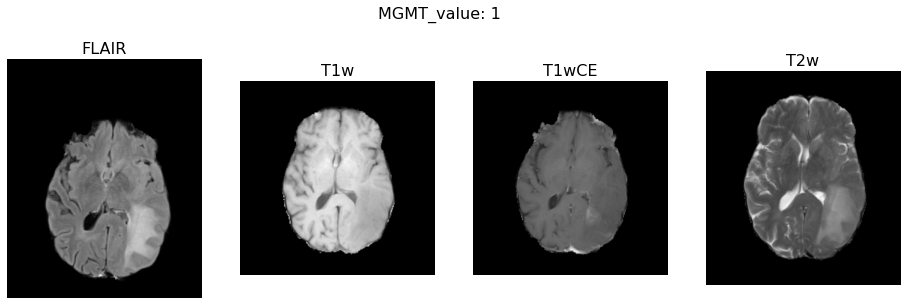

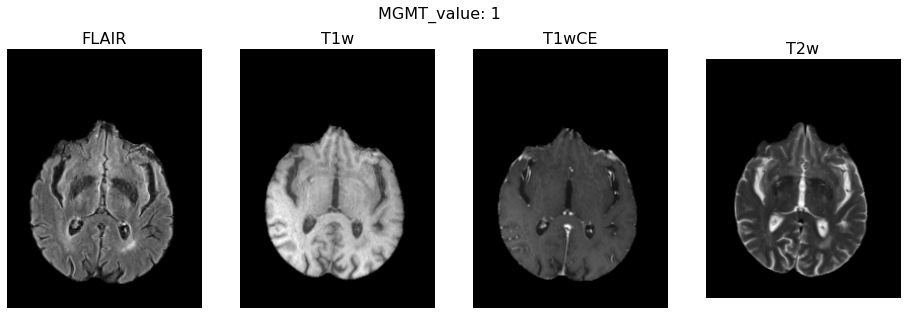

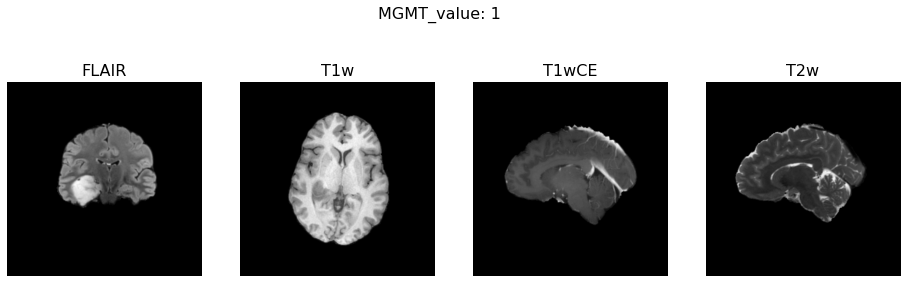

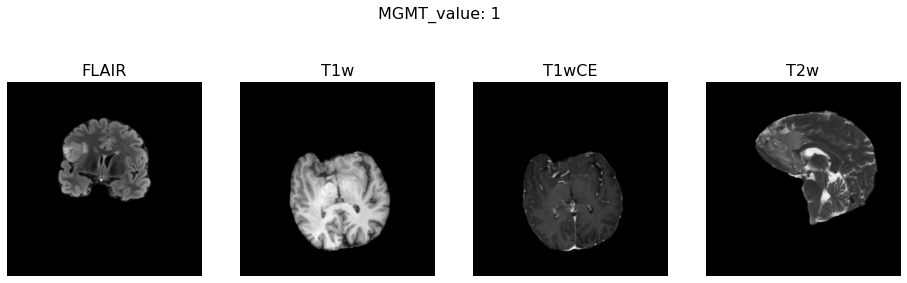

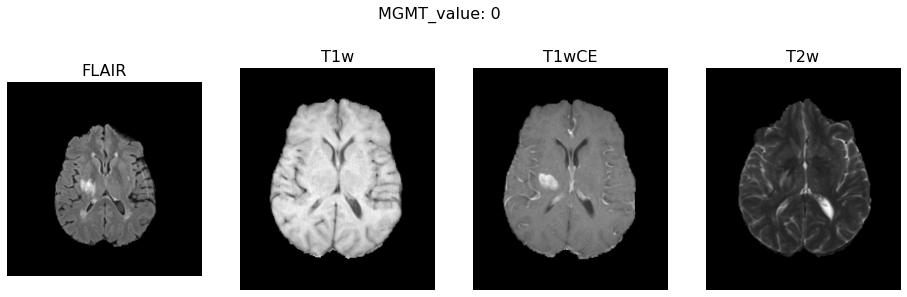

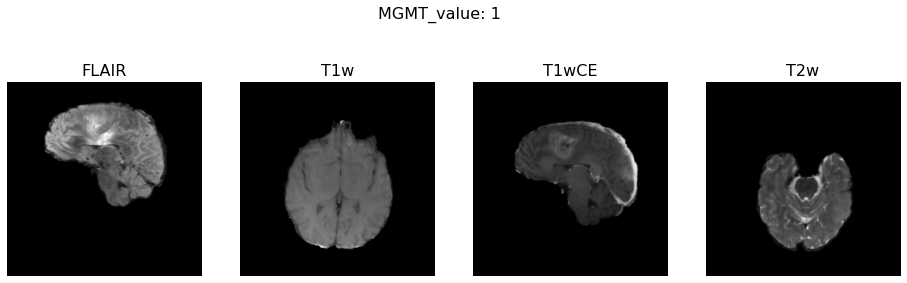

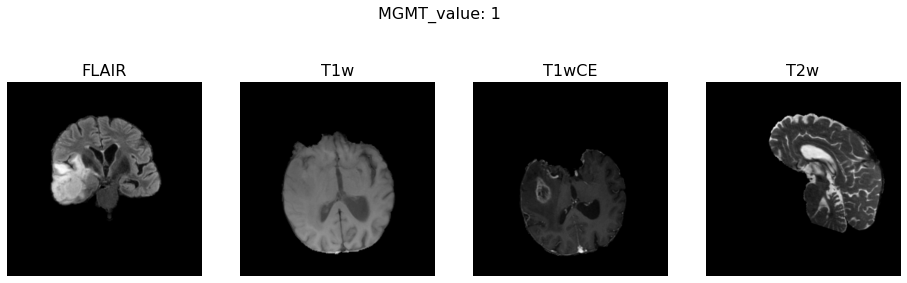

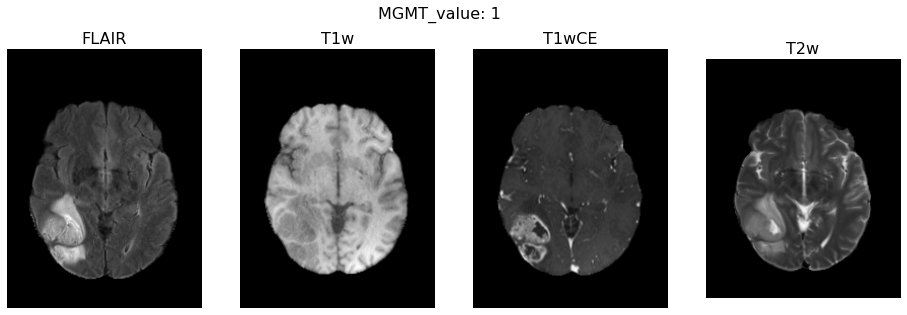

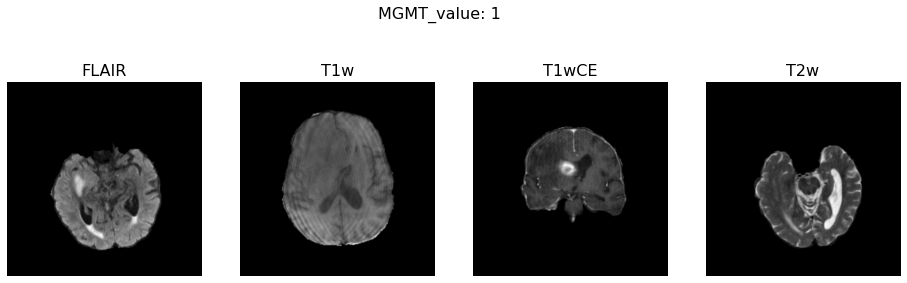

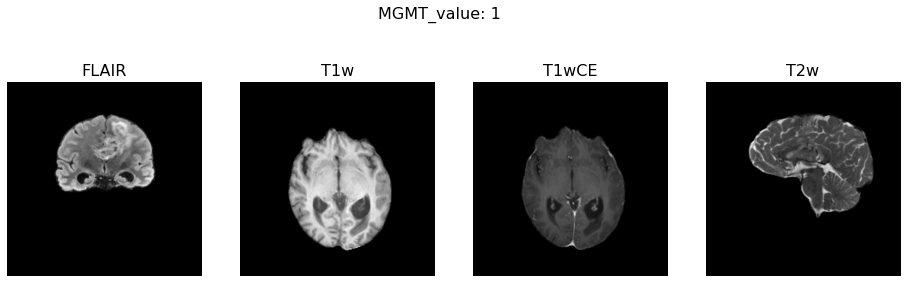

In [ ]:
for i in random.sample(range(train_df.shape[0]), 10):
    _brats21id = train_df.iloc[i]["BraTS21ID"]
    _mgmt_value = train_df.iloc[i]["MGMT_value"]
    visualize_sample(brats21id=_brats21id, mgmt_value=_mgmt_value, slice_i=0.5)

In [ ]:
from matplotlib import animation, rc
rc('animation', html='jshtml')

def create_animation(ims):
    fig = plt.figure(figsize=(6, 6))
    plt.axis("off")
    im = plt.imshow(ims[0], cmap="gray")
    
    def animate_func(i):
        im.set_array(ims[i])
        return [im]

    return animation.FuncAnimation(fig, animate_func, frames=len(ims), interval=1000//24)

def load_dicom_line(path):
    t_paths = sorted(
        glob.glob(os.path.join(path, "*")),
        key=lambda x: int(x[:-4].split("-")[-1]),
    )
    images = []
    for filename in t_paths:
        data = load_dicom(filename)
        if data.max() == 0:
            continue
        images.append(data)

    return images

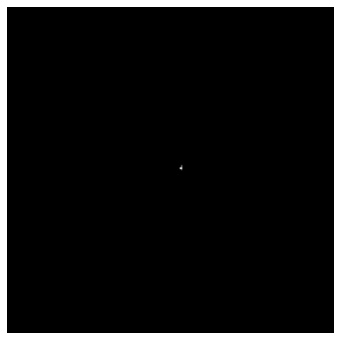

In [ ]:
images = load_dicom_line(os.path.join(DATA_PATH, "00000/FLAIR"))
create_animation(images)

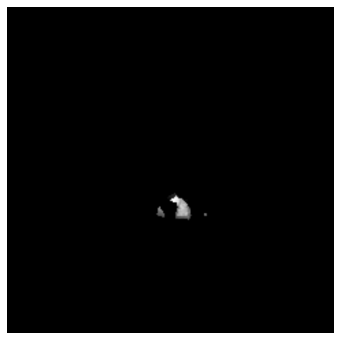

In [ ]:
images = load_dicom_line(os.path.join(DATA_PATH, "00000/T1w"))
create_animation(images)

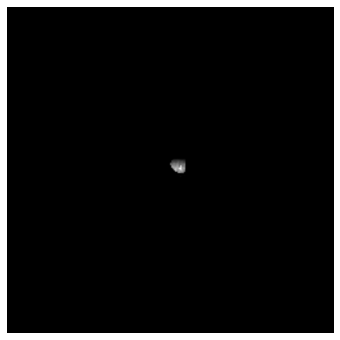

In [ ]:
images = load_dicom_line(os.path.join(DATA_PATH, "00000/T1wCE"))
create_animation(images)

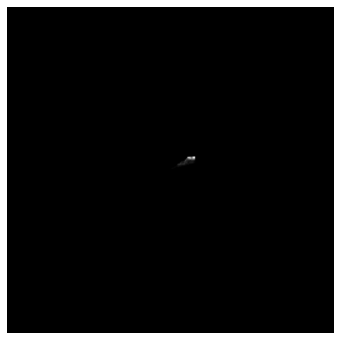

In [ ]:
images = load_dicom_line(os.path.join(DATA_PATH, "00000/T2w"))
create_animation(images)

# Competition Metric

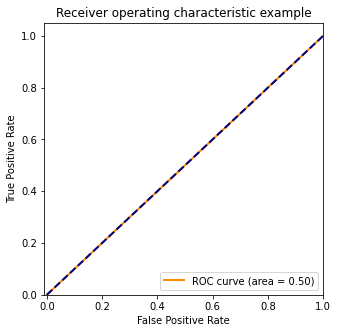

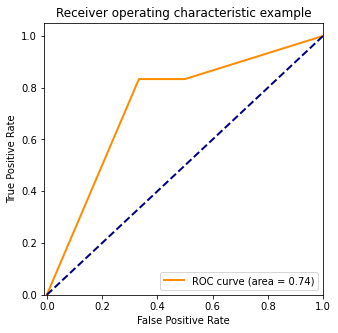

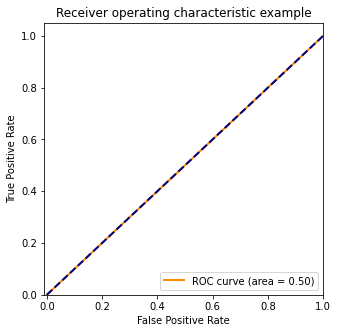

In [ ]:
from sklearn.metrics import roc_auc_score, roc_curve, auc

list_y_true = [
    [1., 1., 1., 1., 1., 1., 0., 0., 0., 0., 0., 0.],
    [1., 1., 1., 1., 1., 1., 0., 0., 0., 0., 0., 0.],
    [1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 0.], #  IMBALANCE
]
list_y_pred = [
    [0.5, 0.5, 0.5, 0.5, 0.5, 0.5, 0.5, 0.5, 0.5, 0.5, 0.5, 0.5],
    [0.9, 0.9, 0.9, 0.9, 0.1, 0.9, 0.9, 0.1, 0.9, 0.1, 0.1, 0.5],
    [1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.], #  IMBALANCE
]

for y_true, y_pred in zip(list_y_true, list_y_pred):
    fpr, tpr, _ = roc_curve(y_true, y_pred)
    roc_auc = auc(fpr, tpr)

    plt.figure(figsize=(5, 5))
    plt.plot(fpr, tpr, color='darkorange', lw=2, label='ROC curve (area = %0.2f)' % roc_auc)
    plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
    plt.xlim([-0.01, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title('Receiver operating characteristic example')
    plt.legend(loc="lower right")
    plt.show()